In [1]:
import numpy as np
import os
import matplotlib.pyplot as plt
from PIL import Image
import tensorflow as tf
import cv2
import random
from tensorflow import keras
import os
from sklearn.metrics import classification_report
import visualkeras
from PIL import ImageFont
from collections import defaultdict

# Data Import

In [2]:
tf.random.set_seed(0)

In [3]:
labeled_data_dir = os.path.join(os.getcwd(), 'data', "updated_masks")

In [4]:
masked_images = [0 for i in range(130)]
smoke_masks = [0 for i in range(130)] 
cloud_masks =[0 for i in range(130)]
image_nos = []
for subdir, dirs, files in os.walk(labeled_data_dir):
    print([file for file in files if "1." in file])
    for file in files:
        file_path = os.path.join(labeled_data_dir, file)
        mask = np.load(os.path.join(labeled_data_dir, file))
        image_no = int(file.split("-")[1])-1
        image_nos.append(image_no)
        if "Smoke" in file_path and not "cloud" in file:
            smoke_masks[image_no] = mask
        if "cloud" in file:
            cloud_masks[image_no] = mask

['task-10-annotation-10-by-1-tag-clouds-1.npy', 'task-62-annotation-64-by-1-tag-clouds-1.npy']


In [5]:
for i in range(len(smoke_masks)):
    if np.shape(cloud_masks[i]) == ():
        blank_img = np.zeros(smoke_masks[i].shape,dtype=np.uint8)
        cloud_masks[i] = blank_img
    if np.shape(smoke_masks[i]) == ():
        blank_img = np.zeros(cloud_masks[i].shape,dtype=np.uint8)
        smoke_masks[i] = blank_img

In [6]:
(len(smoke_masks), len(cloud_masks))

(130, 130)

In [7]:
def combine_masks(smoke_masks, cloud_masks):
    masks = [0 for i in range(len(smoke_masks))]
    for i in range(len(smoke_masks)):
        smoke = smoke_masks[i]
        smoke = np.where(smoke==0, smoke, 1)
        temp = cloud_masks[i]
        temp = np.where(cloud_masks[i]!=255, cloud_masks[i], 2) #changing color to grey
        temp = np.where(cloud_masks[i]==0, temp, 2)
        full_mask = temp + smoke
        full_mask = np.where(full_mask!=3, full_mask, 1 )
        masks[i] = full_mask
    return masks

In [8]:
masked_images = combine_masks(smoke_masks, cloud_masks)

In [9]:
for i in range(len(masked_images)):
    if len(np.unique(masked_images[i])) >3: print(i)

In [10]:
import re
numbers = re.compile(r'(\d+)')

def numericalSort(value):
    parts = numbers.split(value)
    parts[1::2] = map(int, parts[1::2])
    return parts

In [11]:
originals = []
original_image_dir = os.path.join(os.getcwd(), 'data', "updated_images")
for subdir, dirs, files in os.walk(original_image_dir):
    for file in sorted(files, key=numericalSort):
        image = Image.open(os.path.join(original_image_dir, file)).convert('RGB')
        np_original = np.asarray(image)
        originals.append(np_original)
originals = originals[:130]
len(originals)

130

In [12]:
def convert_mask_to_colors(mask):
    mapping = {0: 0, 1: 127.5, 2: 225}
    k = np.array(list(mapping.keys()))
    v = np.array(list(mapping.values()))
    mapping_ar = np.zeros(k.max()+1,dtype=v.dtype)
    mapping_ar[k] = v
    mask = mapping_ar[mask]
    return mask

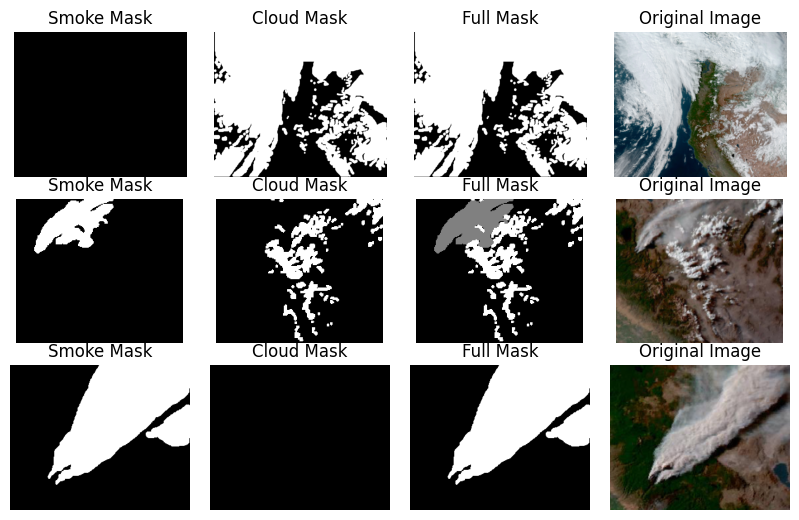

In [13]:
plt.rcParams["figure.figsize"] = (8, 5)
smoke = smoke_masks[102]
smoke = np.where(smoke==0, smoke, 1)
cloud = cloud_masks[102]
cloud = np.where(cloud==0, cloud, 2)
plt.subplot(3, 4, 1)
plt.imshow(convert_mask_to_colors(smoke), cmap="gray")
plt.title("Smoke Mask")
plt.axis("off")

plt.subplot(3, 4, 2)
plt.imshow(convert_mask_to_colors(cloud), cmap="gray")
plt.title("Cloud Mask")
plt.axis("off")

plt.subplot(3, 4, 3)
plt.imshow(masked_images[102], cmap="gray")
plt.title("Full Mask")
plt.axis("off")

plt.subplot(3, 4, 4)
plt.imshow(originals[102])
plt.title("Original Image")
plt.axis("off")

smoke = smoke_masks[119]
smoke = np.where(smoke==0, smoke, 1)
cloud = cloud_masks[119]
cloud = np.where(cloud==0, cloud, 2)
plt.subplot(3, 4, 5)
plt.imshow(convert_mask_to_colors(smoke), cmap="gray")
plt.title("Smoke Mask")
plt.axis("off")

plt.subplot(3, 4, 6)
plt.imshow(convert_mask_to_colors(cloud), cmap="gray")
plt.title("Cloud Mask")
plt.axis("off")

plt.subplot(3, 4, 7)
plt.imshow(masked_images[119], cmap="gray")
plt.title("Full Mask")
plt.axis("off")

plt.subplot(3, 4, 8)
plt.imshow(originals[119])
plt.title("Original Image")
plt.axis("off")

smoke = smoke_masks[123]
smoke = np.where(smoke==0, smoke, 1)
cloud = cloud_masks[123]
cloud = np.where(cloud==0, cloud, 2)

plt.subplot(3, 4, 9)
plt.imshow(convert_mask_to_colors(smoke), cmap="gray")
plt.title("Smoke Mask")
plt.axis("off")

plt.subplot(3, 4, 10)
plt.imshow(convert_mask_to_colors(cloud), cmap="gray")
plt.title("Cloud Mask")
plt.axis("off")

plt.subplot(3, 4, 11)
plt.imshow(masked_images[123], cmap="gray")
plt.title("Full Mask")
plt.axis("off")

plt.subplot(3, 4, 12)
plt.imshow(originals[123])
plt.title("Original Image")
plt.axis("off")
plt.tight_layout(pad=0)
plt.subplots_adjust(wspace=0)
plt.savefig('inputs.pdf', bbox_inches="tight") 

In [14]:
random.seed(42)
inds = random.sample([i for i in range(130)], 25)

In [15]:
import math
def get_image_tiles_reshape(image, kernel_size):
    height, width, channels = image.shape
    tile_height, tile_width = kernel_size
    tiled_array = image.reshape(height // tile_height, tile_height,
                                width // tile_width, tile_width,
                                channels)
    tiled_array = tiled_array.swapaxes(1,2)
    tiled_shape = tiled_array.shape
    tiled_array = tiled_array.reshape(-1, *tiled_array.shape[2:])
    return tiled_array, tiled_shape

def get_tiles(tile_kernel, image, target_shape, pixel_mult=1):
    padding_tuple = ((0,0), (0,0), (0,0)) 
    padded_image = image
    if tile_kernel is None:
            kernel = math.gcd(image.shape[0], image.shape[1])
            if kernel < min(target_shape): #no GCD - this happens with the screen shots
                kernel_1 =  image.shape[0]//(target_shape[0]*pixel_mult)
                kernel_2 = image.shape[1]//(target_shape[1]*pixel_mult)
                remainders = (image.shape[0]%(target_shape[0]*pixel_mult), image.shape[1]%(target_shape[1]*pixel_mult))
                if kernel_1 <= 1 and kernel_2 <= 1: #can only fit one tile
                    tile_kernel = target_shape# (image.shape[0], image.shape[1])
                    padded_image = cv2.resize(image, target_shape)
                else: #can fit multiple tiles
                    tile_kernel = (target_shape[0]*pixel_mult, target_shape[1]*pixel_mult)
                    padding_tuple = ((0, (target_shape[0]*pixel_mult)-remainders[0]), (0, (target_shape[1]*pixel_mult)-remainders[1]), (0, 0))
                    padded_image = np.pad(image, padding_tuple, 'constant', constant_values=(0))
            else:
                tile_kernel = (kernel, kernel)
    tiled_array, full_tiled_shape = get_image_tiles_reshape(padded_image, tile_kernel)
    tile_shape = full_tiled_shape[2:]
    images = tiled_array
    return images, tile_shape, full_tiled_shape, padding_tuple

def get_mask_tiles_reshape(image, kernel_size):
    height, width = image.shape
    tile_height, tile_width = kernel_size
    tiled_array = image.reshape(height // tile_height, tile_height,
                                width // tile_width, tile_width)
    tiled_array = tiled_array.swapaxes(1,2)
    tiled_shape = tiled_array.shape
    tiled_array = tiled_array.reshape(-1, *tiled_array.shape[2:])
    return tiled_array, tiled_shape

def get_mask_tiles(tile_kernel, image, target_shape, pixel_mult=1):
    padding_tuple = ((0,0), (0,0))
    padded_image = image
    if tile_kernel is None:
            kernel = math.gcd(image.shape[0], image.shape[1])
            if kernel < min(target_shape): # no GCD - this happens with the screen shots
                kernel_1 =  image.shape[0]//(target_shape[0]*pixel_mult)
                kernel_2 = image.shape[1]//(target_shape[1]*pixel_mult)
                remainders = (image.shape[0]%(target_shape[0]*pixel_mult), image.shape[1]%(target_shape[1]*pixel_mult))
                if kernel_1 <= 1 and kernel_2 <= 1: # can only fit one tile
                    tile_kernel = target_shape # (image.shape[0], image.shape[1])
                    padded_image = cv2.resize(np.expand_dims(image, axis=-1), target_shape)
                else: #can fit multiple tiles
                    tile_kernel = (target_shape[0]*pixel_mult, target_shape[1]*pixel_mult)
                    padding_tuple = ((0, (target_shape[0]*pixel_mult)-remainders[0]), (0, (target_shape[1]*pixel_mult)-remainders[1]))
                    padded_image = np.pad(image, padding_tuple, 'constant', constant_values=(0))
            else:
                tile_kernel = (kernel, kernel)
    tiled_array, full_tiled_shape = get_mask_tiles_reshape(padded_image, tile_kernel)
    tile_shape = full_tiled_shape[2:]
    images = tiled_array
    return images, tile_shape, full_tiled_shape, padding_tuple
     

In [16]:
#development data loader for loading tiled data - not currently in use
class TiledDataLoader:
    def __init__(self, masks, originals, target_shape=(128, 128)):
        self.masks = masks
        self.originals = originals
        self.AUTOTUNE = tf.data.experimental.AUTOTUNE
        self.target_shape = target_shape
        
    @tf.function
    def parse_images(self, ind): #add tilling here
        mask = self.masks[ind]
        image = self.originals[ind]
        images, _, _, _ = get_tiles(None, image, self.target_shape)
        masks, _, _, _ = get_mask_tiles(None, mask, self.target_shape)
        return images, masks
  
    @tf.function
    def data_generator(self, batch_size=4):
        inds = random.sample([i for i in range(len(self.originals))], batch_size)
        inputs = [self.parse_images(ind)[0][im] for ind in inds for im in range(len(self.parse_images(ind)[0]))] # error, it does not let me pull the images and masks individually
        targets = [self.parse_images(ind)[1][m] for ind in inds for m in range(len(self.parse_images(ind)[1]))]  # https://stackoverflow.com/questions/62068323/iterating-over-tf-tensor-is-not-allowed-autograph-is-disabled-in-this-function 
        return inputs, targets
    

In [17]:
class DataLoader:
    def __init__(self, masks, originals, target_shape=(256, 256)):
        self.masks = masks
        self.originals = originals
        self.AUTOTUNE = tf.data.experimental.AUTOTUNE
        self.target_shape = target_shape
        
    @tf.function
    def parse_images(self, ind):
        mask = cv2.resize(np.expand_dims(self.masks[ind], axis=-1), self.target_shape)
        image = cv2.resize(self.originals[ind], self.target_shape)
        return image, mask
    
    @tf.function
    def data_generator(self, batch_size=4):
        random.seed(0)
        inds = random.sample([i for i in range(len(self.originals))], batch_size)
        inputs = [self.parse_images(ind)[0] for ind in inds]
        targets = [self.parse_images(ind)[1] for ind in inds]
        return inputs, targets

    def data_processor(self):
        inputs = [ cv2.resize(self.originals[ind], self.target_shape) for ind in range(len(self.originals))]
        return inputs

In [18]:
def Conv2dBlock(input_layer, num_filters, kernel=3, BatchNorm=True):
    # first convolution
    x = tf.keras.layers.Conv2D(filters=num_filters, 
                               kernel_size=(kernel, kernel), 
                               kernel_initializer='he_normal', 
                               padding='same')(input_layer)
    if BatchNorm:
        x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)
    # second convolution
    x = tf.keras.layers.Conv2D(filters=num_filters, 
                               kernel_size=(kernel, kernel), 
                               kernel_initializer='he_normal', 
                               padding='same')(x)
    if BatchNorm:
        x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation('relu')(x)
    return x

def Unet(input, num_filters=16, dropout=0.1, BatchNorm=True):
    # Contraction phase - includes 4 rounds of convolution block -> max pooling
    # round 1
    c1 = Conv2dBlock(input, num_filters*1, kernel=3, BatchNorm=BatchNorm)
    p1 = tf.keras.layers.MaxPooling2D((2,2))(c1)
    p1 = tf.keras.layers.Dropout(dropout)(p1)
    # round 2
    c2 = Conv2dBlock(p1, num_filters*2, kernel=3, BatchNorm=BatchNorm)
    p2 = tf.keras.layers.MaxPooling2D((2,2))(c2)
    p2 = tf.keras.layers.Dropout(dropout)(p2)
    # round 3
    c3 = Conv2dBlock(p2, num_filters*4, kernel=3, BatchNorm=BatchNorm)
    p3 = tf.keras.layers.MaxPooling2D((2,2))(c3)
    p3 = tf.keras.layers.Dropout(dropout)(p3)
    # round 4
    c4 = Conv2dBlock(p3, num_filters*8, kernel=3, BatchNorm=BatchNorm)
    p4 = tf.keras.layers.MaxPooling2D((2,2))(c4)
    p4 = tf.keras.layers.Dropout(dropout)(p4)

    # Bottle neck phase - expands the feature dimension
    c5 = Conv2dBlock(p4, num_filters*16, kernel=3, BatchNorm=BatchNorm)
    
    # Expansion phase - includes 4 rounds of upsampling -> concatenation -> convolution block
    # round 1
    u6 = tf.keras.layers.Conv2DTranspose(num_filters*8, (3, 3), strides = (2, 2), padding = 'same')(c5)
    u6 = tf.keras.layers.concatenate([u6, c4])
    u6 = tf.keras.layers.Dropout(dropout)(u6)
    c6 = Conv2dBlock(u6, num_filters * 8, kernel=3, BatchNorm=BatchNorm)
    # round 2
    u7 = tf.keras.layers.Conv2DTranspose(num_filters*4, (3, 3), strides = (2, 2), padding = 'same')(c6)
    u7 = tf.keras.layers.concatenate([u7, c3])
    u7 = tf.keras.layers.Dropout(dropout)(u7)
    c7 = Conv2dBlock(u7, num_filters * 4, kernel=3, BatchNorm=BatchNorm)
    # round 3
    u8 = tf.keras.layers.Conv2DTranspose(num_filters*2, (3, 3), strides = (2, 2), padding = 'same')(c7)
    u8 = tf.keras.layers.concatenate([u8, c2])
    u8 = tf.keras.layers.Dropout(dropout)(u8)
    c8 = Conv2dBlock(u8, num_filters * 2, kernel=3, BatchNorm=BatchNorm)
    # round 4
    u9 = tf.keras.layers.Conv2DTranspose(num_filters*1, (3, 3), strides = (2, 2), padding = 'same')(c8)
    u9 = tf.keras.layers.concatenate([u9, c1])
    u9 = tf.keras.layers.Dropout(dropout)(u9)
    c9 = Conv2dBlock(u9, num_filters * 1, kernel=3, BatchNorm=BatchNorm)
    
    # output layer - 3 classes 
    output = tf.keras.layers.Conv2D(3, (1, 1), activation='softmax')(c9)
    model = tf.keras.Model(inputs=[input], outputs=[output])
    return model

In [19]:
def training_plots(history):
    # Learning Rate
    plt.plot(history.history['lr'])
    plt.title('Learning Rate')
    plt.xlabel("Epochs")
    plt.ylabel("LR Value")
    plt.show()

    # Loss Curves
    plt.plot(history.history['loss'], label="Train Loss")
    plt.plot(history.history['val_loss'], label="Val Loss")
    plt.title('Loss Curves')
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

    # Accuracy Curves
    plt.plot(history.history['accuracy'], label="Train Accuracy")
    plt.plot(history.history['val_accuracy'], label="Val Accuracy")
    plt.title('Accuracy Curves')
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.legend()
    plt.show()

    # IoU Curves
    plt.plot(history.history['mean_io_u'], label="Train IoU")
    plt.plot(history.history['val_mean_io_u'], label="Val IoU")
    plt.title('IoU Curves')
    plt.xlabel("Epochs")
    plt.ylabel("IoU")
    plt.legend()
    plt.show()

In [20]:
def create_mask(pred_mask):
    pred_mask = tf.argmax(pred_mask, axis=-1) 
    pred_mask = tf.expand_dims(pred_mask, axis=-1)
    return pred_mask

In [21]:
def plot_validation_masks(inputs, preds, targets):
    plt.rcParams["figure.figsize"] = (20, 5)

    for i, p, t in zip(inputs, preds, targets):
        p = create_mask(p)
        plt.subplot(1, 3, 1)
        plt.imshow(i)
        plt.title("Input Image")
        plt.axis("off")
    
        plt.subplot(1, 3, 2)
        plt.imshow(convert_mask_to_colors(p), cmap="gray")
        plt.title("Predicted Mask",)
        plt.axis("off")
        
        plt.subplot(1, 3, 3)
        plt.imshow(convert_mask_to_colors(t), cmap="gray")
        plt.title("True Mask")
        plt.axis("off")
        plt.show()

# (256,256) input

In [22]:
input_size = (256, 256)

In [23]:
input = tf.keras.layers.Input(shape=(input_size[0], input_size[1], 3))
unet = Unet(input, dropout= 0.07)

In [24]:
unet.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 16  448         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 256, 256, 16  64         ['conv2d[0][0]']                 
 alization)                     )                                                             

In [22]:
#tf.keras.utils.plot_model(unet, to_file="figures/256_keras_mdl.png", show_shapes=True, rankdir='TD')

In [26]:
# Callbacks
early_stop_cb = tf.keras.callbacks.EarlyStopping(
    monitor="val_loss",
    min_delta=0,
    patience=10,
    verbose=1,
    mode="auto",
    baseline=None,
    restore_best_weights=True,
)
model_ckpt_cb = tf.keras.callbacks.ModelCheckpoint(
    "models/smoke_segmentation_256.h5",
    monitor="val_loss",
    verbose=0,
    save_best_only=True,
    save_weights_only=False,
    mode="auto",
    save_freq="epoch",
)
reduce_lr_cb = tf.keras.callbacks.ReduceLROnPlateau(
    monitor="val_loss",
    factor=0.1,
    patience=5,
    verbose=1,
    mode="auto",
    min_delta=0.0001,
    cooldown=0,
    min_lr=10e-8,
)


In [27]:
# training parameters
batch_size = 4
val_batch_size = 2
epochs = 500
lr = 0.00001

In [28]:
unet.compile(
    loss="sparse_categorical_crossentropy", 
    optimizer=tf.keras.optimizers.Adam(learning_rate=lr), 
    metrics=["accuracy", 
             tf.keras.metrics.MeanIoU(num_classes=3, sparse_y_true=True, sparse_y_pred=False)]
            )

In [29]:
test_dataset = DataLoader(masked_images, originals, target_shape=input_size)
inputs, targets = test_dataset.data_generator(130)

In [30]:
val_input = [inputs[ind] for ind in inds]
val_target = [targets[ind] for ind in inds]
val = tf.data.Dataset.from_tensor_slices((val_input, val_target))

In [31]:
inputs = [inputs[ind] for ind in range(130) if ind not in inds]
targets = [targets[ind] for ind in range(130) if ind not in inds]
train = tf.data.Dataset.from_tensor_slices((inputs, targets))

In [32]:
train_batches = train.batch(batch_size)
val_batches = val.batch(val_batch_size)

In [33]:
history = unet.fit(
    train_batches,
    validation_data=val_batches,
    batch_size=batch_size,
    epochs=epochs, 
    callbacks=[
        early_stop_cb, 
        model_ckpt_cb, 
        reduce_lr_cb
    ])

Epoch 1/500
27/27 [==============================] - 38s 1s/step - loss: 1.1586 - accuracy: 0.3385 - mean_io_u: 0.1929 - val_loss: 2.9478 - val_accuracy: 0.2442 - val_mean_io_u: 0.1108 - lr: 1.0000e-05
Epoch 2/500
27/27 [==============================] - 29s 1s/step - loss: 1.1285 - accuracy: 0.3575 - mean_io_u: 0.2046 - val_loss: 1.7956 - val_accuracy: 0.3031 - val_mean_io_u: 0.1605 - lr: 1.0000e-05
Epoch 3/500
27/27 [==============================] - 31s 1s/step - loss: 1.1012 - accuracy: 0.3789 - mean_io_u: 0.2179 - val_loss: 1.3818 - val_accuracy: 0.3501 - val_mean_io_u: 0.2040 - lr: 1.0000e-05
Epoch 4/500
27/27 [==============================] - 30s 1s/step - loss: 1.0752 - accuracy: 0.4031 - mean_io_u: 0.2332 - val_loss: 1.1840 - val_accuracy: 0.3973 - val_mean_io_u: 0.2440 - lr: 1.0000e-05
Epoch 5/500
27/27 [==============================] - 30s 1s/step - loss: 1.0507 - accuracy: 0.4301 - mean_io_u: 0.2505 - val_loss: 1.0752 - val_accuracy: 0.4492 - val_mean_io_u: 0.2819 - lr: 1

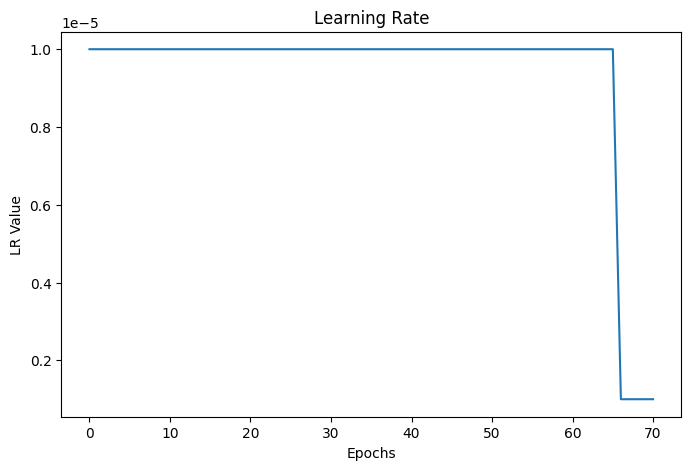

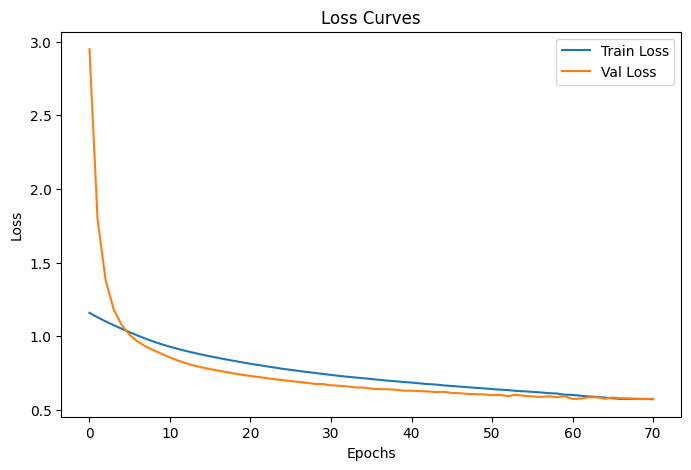

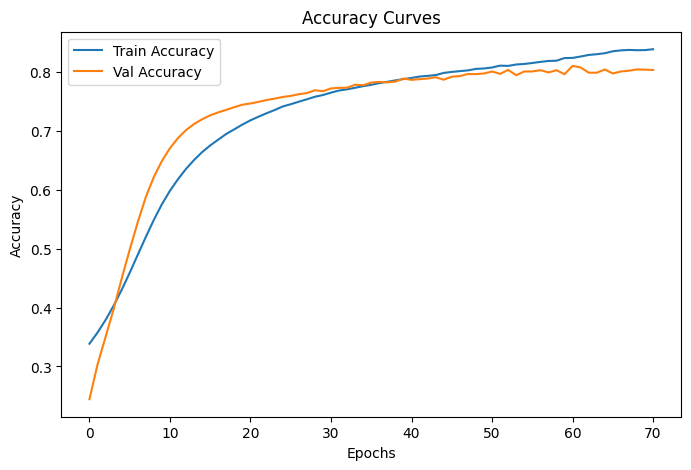

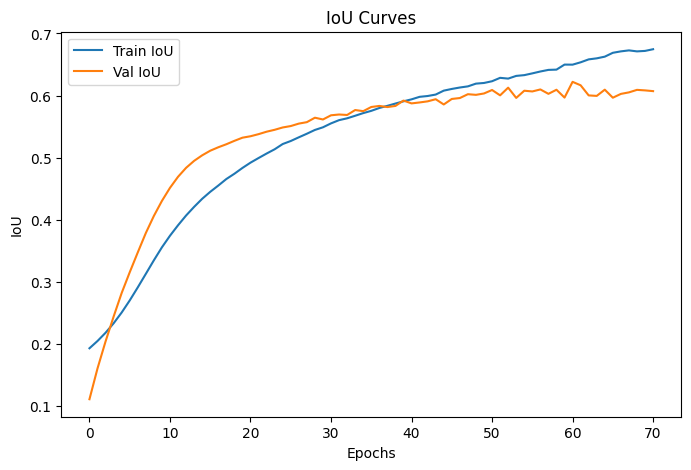

In [34]:
training_plots(history)

In [35]:
from tensorflow.python.ops.numpy_ops import np_config
np_config.enable_numpy_behavior()

In [36]:
train_images, train_labels = tuple(zip(*train))
preds = unet.predict(train_batches)

27/27 [==============================] - 5s 157ms/step


In [37]:
print(classification_report(np.array(train_labels).flatten(), np.array(tf.argmax(preds, axis=-1)).flatten()))

              precision    recall  f1-score   support

           0       0.91      0.90      0.91   4233266
           1       0.60      0.79      0.68   1289925
           2       0.85      0.64      0.73   1358089

    accuracy                           0.83   6881280
   macro avg       0.79      0.77      0.77   6881280
weighted avg       0.84      0.83      0.83   6881280



In [38]:
m = tf.keras.metrics.MeanIoU(num_classes=3)
m.update_state(train_labels, tf.argmax(preds, axis=-1))
m.result().numpy()

0.637935

In [39]:
images, labels = tuple(zip(*val))
preds = unet.predict(val_batches)

13/13 [==============================] - 1s 76ms/step


In [40]:
pred_mask = tf.argmax(preds, axis=-1) 

In [41]:
m.reset_state()
m.update_state(labels, pred_mask)
m.result().numpy()

0.6221277

In [42]:
print(classification_report(np.array(labels).flatten(), np.array(pred_mask).flatten()))

              precision    recall  f1-score   support

           0       0.86      0.94      0.90    910684
           1       0.67      0.64      0.66    351203
           2       0.80      0.65      0.72    376513

    accuracy                           0.81   1638400
   macro avg       0.78      0.74      0.76   1638400
weighted avg       0.81      0.81      0.81   1638400



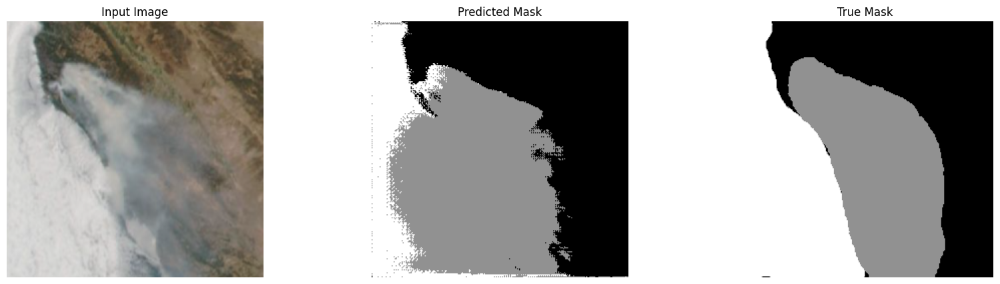

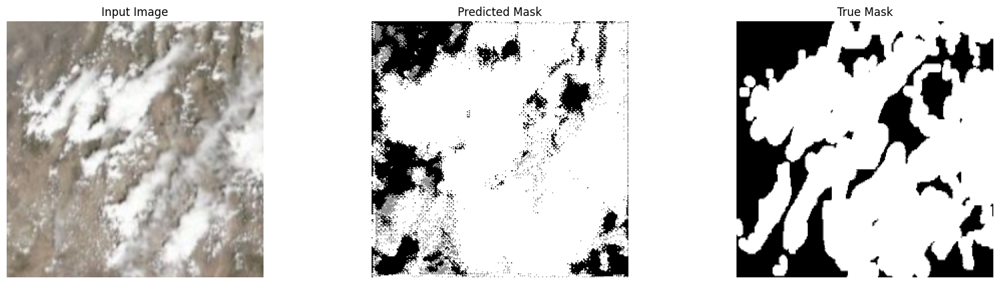

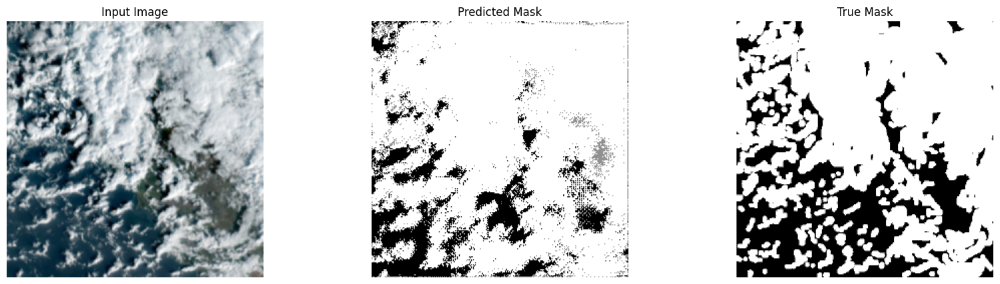

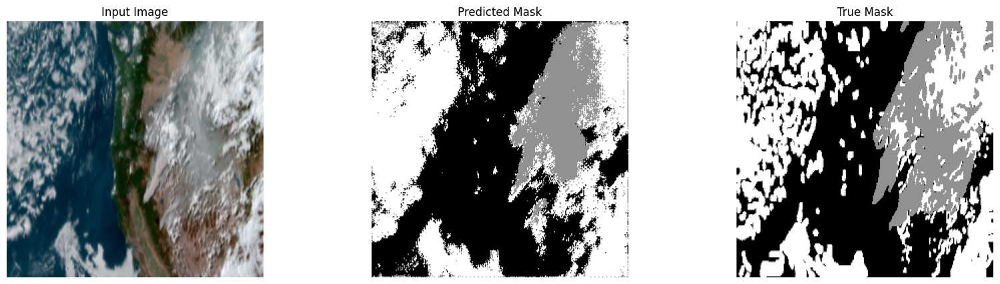

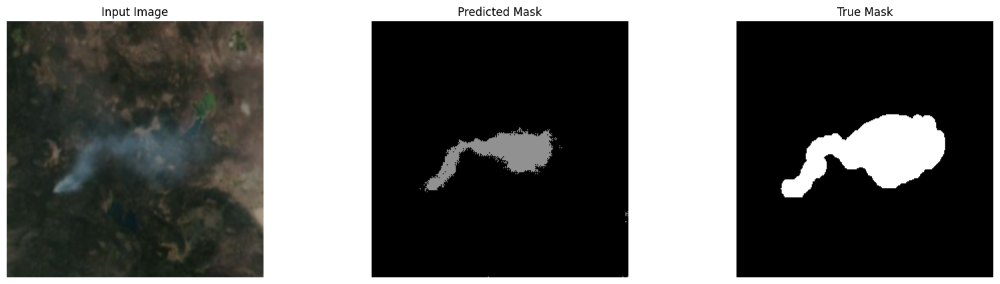

...

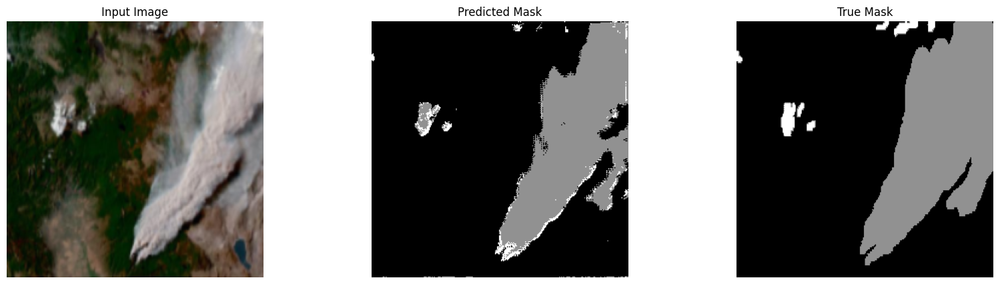

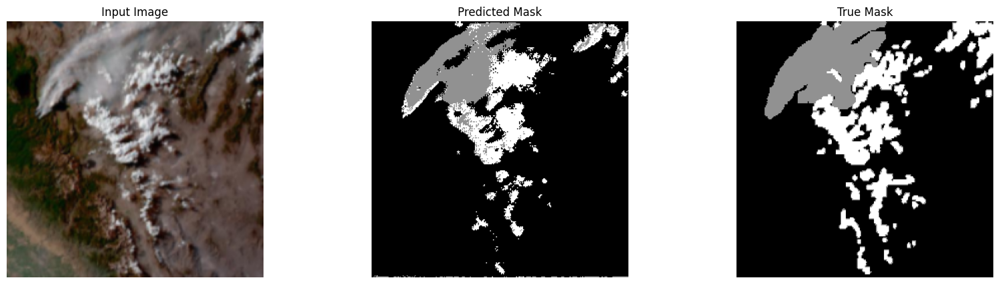

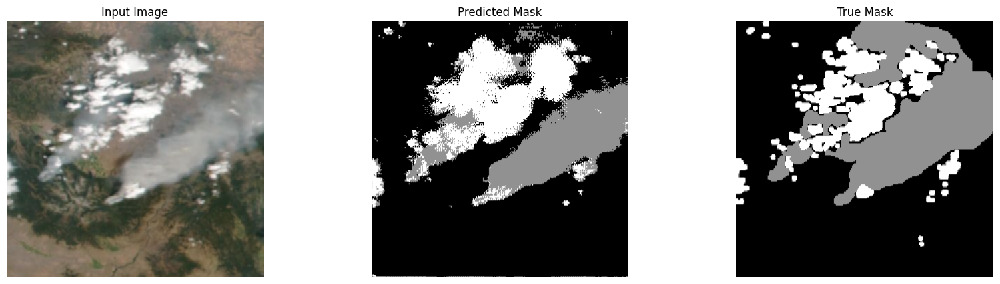

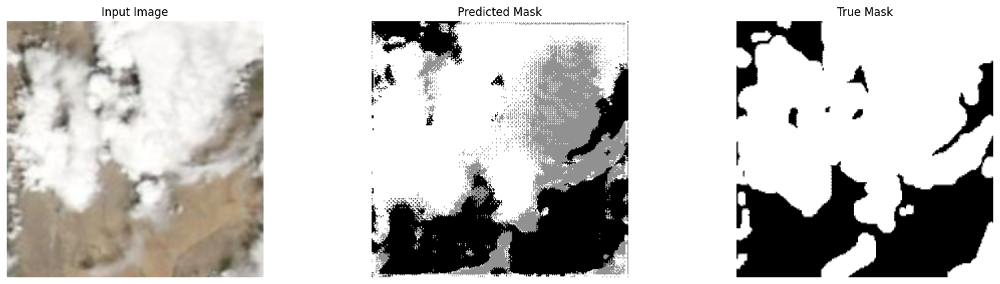

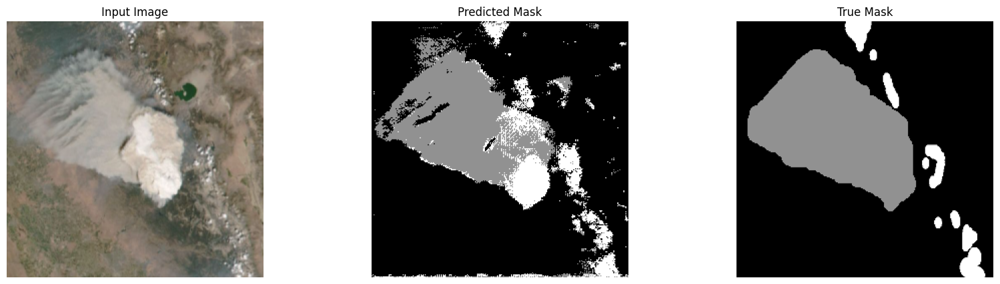

In [43]:

plot_validation_masks(images, preds, labels)

In [44]:
unet.save("models/smoke_segmentation_final_256.h5")

In [45]:
mdl = keras.models.load_model("models/smoke_segmentation_final_256.h5")

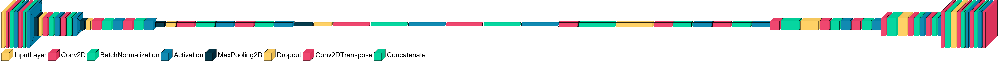

In [46]:
color_map = defaultdict(dict)
color_map[keras.layers.InputLayer]["fill"] = "yellow"
color_map[keras.layers.Conv2D]['fill'] = 'red'
color_map[keras.layers.BatchNormalization]['fill'] = 'green'
color_map[keras.layers.Dropout]['fill'] = 'blue'
color_map[keras.layers.MaxPooling2D]['fill'] = 'teal'
color_map[keras.layers.Conv2DTranspose]['fill'] = "red"
color_map[keras.layers.Concatenate]['fill'] = "grey"
font = ImageFont.truetype("arial.ttf", 48)
visualkeras.layered_view(mdl, legend=True, scale_xy=1, scale_z=1, max_z=1000,font=font,to_file='figures/256_mdl.png', type_ignore=["Activation"])

# (512, 512)

In [23]:
input_size = (512, 512)

In [24]:
input = tf.keras.layers.Input(shape=(input_size[0], input_size[1], 3))
unet_512 = Unet(input, dropout=0.07)

In [25]:
unet_512.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 512, 512, 16  448         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 512, 512, 16  64         ['conv2d[0][0]']                 
 alization)                     )                                                             

In [26]:
#tf.keras.utils.plot_model(unet_512, to_file="figures/512_keras_mdl.png", show_shapes=True, rankdir="TD")

In [27]:
# Callbacks
early_stop_cb = tf.keras.callbacks.EarlyStopping(
    monitor="val_loss",
    min_delta=0,
    patience=10,
    verbose=1,
    mode="auto",
    baseline=None,
    restore_best_weights=True,
)
model_ckpt_cb = tf.keras.callbacks.ModelCheckpoint(
    "models/smoke_segmentation_512.h5",
    monitor="val_loss",
    verbose=0,
    save_best_only=True,
    save_weights_only=False,
    mode="auto",
    save_freq="epoch",
)
reduce_lr_cb = tf.keras.callbacks.ReduceLROnPlateau(
    monitor="val_loss",
    factor=0.1,
    patience=5,
    verbose=1,
    mode="auto",
    min_delta=0.0001,
    cooldown=0,
    min_lr=10e-8,
)


In [28]:
# training parameters
batch_size = 4
val_batch_size = 2
epochs = 500
lr = 0.00001

In [29]:
unet_512.compile(
    loss="sparse_categorical_crossentropy", 
    optimizer=tf.keras.optimizers.Adam(learning_rate=lr), 
    metrics=["accuracy", 
             tf.keras.metrics.MeanIoU(num_classes=3, sparse_y_true=True, sparse_y_pred=False)]
            )

In [30]:
test_dataset = DataLoader(masked_images, originals, target_shape=input_size)
inputs, targets = test_dataset.data_generator(130)

In [31]:
val_input = [inputs[ind] for ind in inds]
val_target = [targets[ind] for ind in inds]
val = tf.data.Dataset.from_tensor_slices((val_input, val_target))

In [32]:
inputs = [inputs[ind] for ind in range(130) if ind not in inds]
targets = [targets[ind] for ind in range(130) if ind not in inds]
train = tf.data.Dataset.from_tensor_slices((inputs, targets))

In [33]:
train_batches = train.batch(batch_size)
val_batches = val.batch(val_batch_size)

In [34]:
history_512 = unet_512.fit(
    train_batches,
    validation_data=val_batches,
    batch_size=batch_size,
    epochs=epochs, 
    callbacks=[
        early_stop_cb, 
        model_ckpt_cb, 
        reduce_lr_cb
    ])

Epoch 1/500
27/27 [==============================] - 116s 4s/step - loss: 1.1503 - accuracy: 0.3389 - mean_io_u: 0.1927 - val_loss: 2.9171 - val_accuracy: 0.2457 - val_mean_io_u: 0.1095 - lr: 1.0000e-05
Epoch 2/500
27/27 [==============================] - 111s 4s/step - loss: 1.1167 - accuracy: 0.3599 - mean_io_u: 0.2055 - val_loss: 1.7633 - val_accuracy: 0.3068 - val_mean_io_u: 0.1618 - lr: 1.0000e-05
Epoch 3/500
27/27 [==============================] - 118s 4s/step - loss: 1.0858 - accuracy: 0.3841 - mean_io_u: 0.2203 - val_loss: 1.3459 - val_accuracy: 0.3551 - val_mean_io_u: 0.2093 - lr: 1.0000e-05
Epoch 4/500
27/27 [==============================] - 120s 4s/step - loss: 1.0568 - accuracy: 0.4121 - mean_io_u: 0.2380 - val_loss: 1.1482 - val_accuracy: 0.4139 - val_mean_io_u: 0.2575 - lr: 1.0000e-05
Epoch 5/500
27/27 [==============================] - 115s 4s/step - loss: 1.0296 - accuracy: 0.4431 - mean_io_u: 0.2580 - val_loss: 1.0382 - val_accuracy: 0.4793 - val_mean_io_u: 0.3039 - 

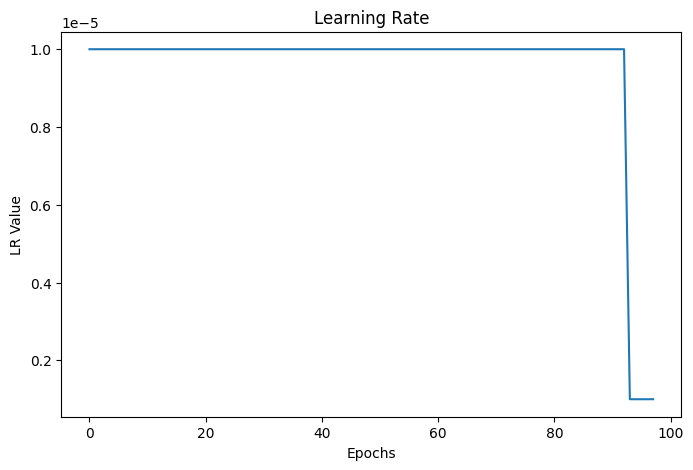

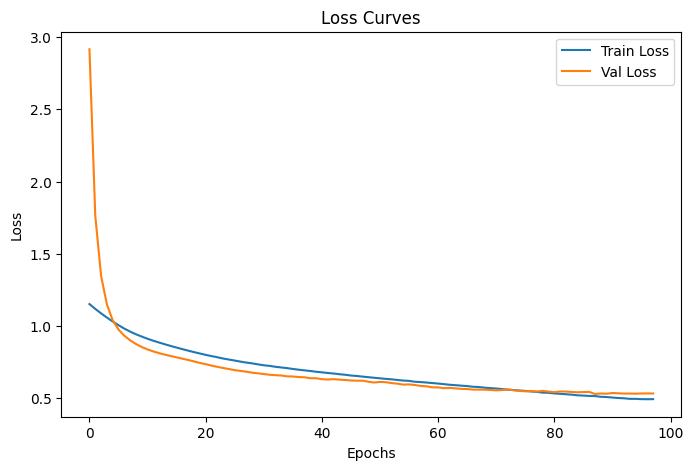

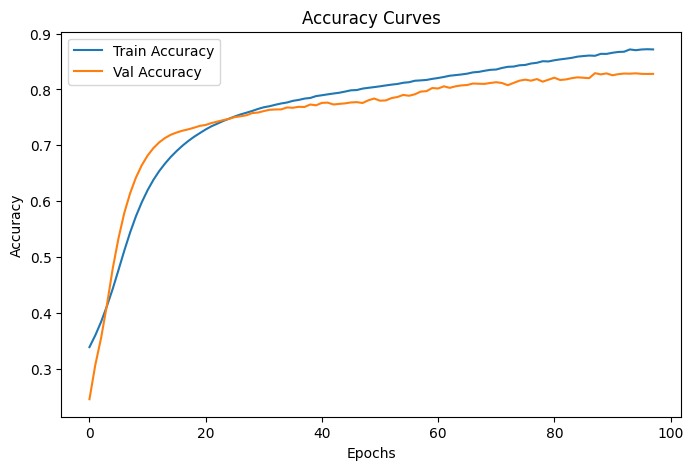

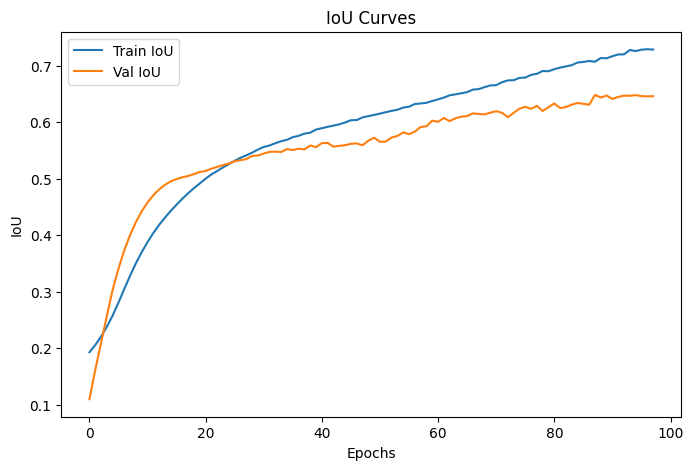

In [35]:
training_plots(history_512)

In [36]:
from tensorflow.python.ops.numpy_ops import np_config
np_config.enable_numpy_behavior()

In [37]:
train_images, train_labels = tuple(zip(*train))
preds = unet_512.predict(train_batches)

27/27 [==============================] - 17s 613ms/step


In [38]:
print(classification_report(np.array(train_labels).flatten(), np.array(tf.argmax(preds, axis=-1)).flatten()))

              precision    recall  f1-score   support

           0       0.91      0.92      0.91  16931837
           1       0.60      0.78      0.68   5158511
           2       0.88      0.61      0.72   5434772

    accuracy                           0.83  27525120
   macro avg       0.80      0.77      0.77  27525120
weighted avg       0.85      0.83      0.83  27525120



In [39]:
m = tf.keras.metrics.MeanIoU(num_classes=3)
m.update_state(train_labels, tf.argmax(preds, axis=-1))
m.result().numpy()

0.6398269

In [40]:
images, labels = tuple(zip(*val))
preds = unet_512.predict(val_batches)

13/13 [==============================] - 4s 294ms/step


In [41]:
pred_mask = tf.argmax(preds, axis=-1) 

In [42]:
m.reset_state()
m.update_state(labels, pred_mask)
m.result().numpy()

0.648538

In [43]:
print(classification_report(np.array(labels).flatten(), np.array(pred_mask).flatten()))

              precision    recall  f1-score   support

           0       0.87      0.96      0.91   3642002
           1       0.69      0.71      0.70   1405225
           2       0.87      0.62      0.73   1506373

    accuracy                           0.83   6553600
   macro avg       0.81      0.76      0.78   6553600
weighted avg       0.83      0.83      0.82   6553600



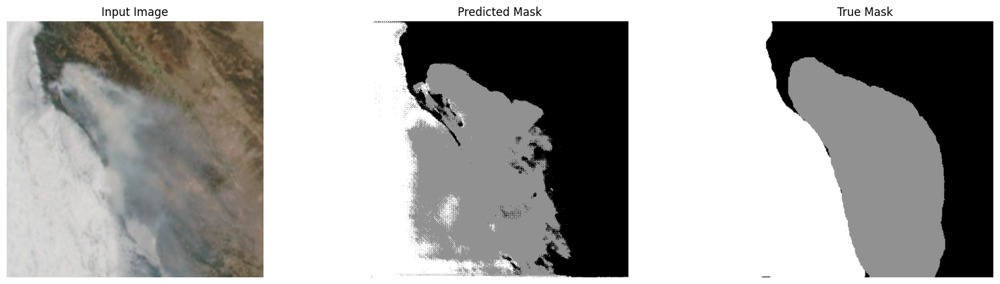

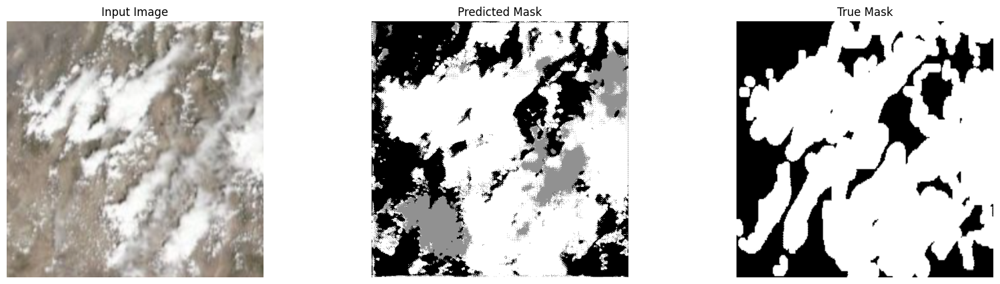

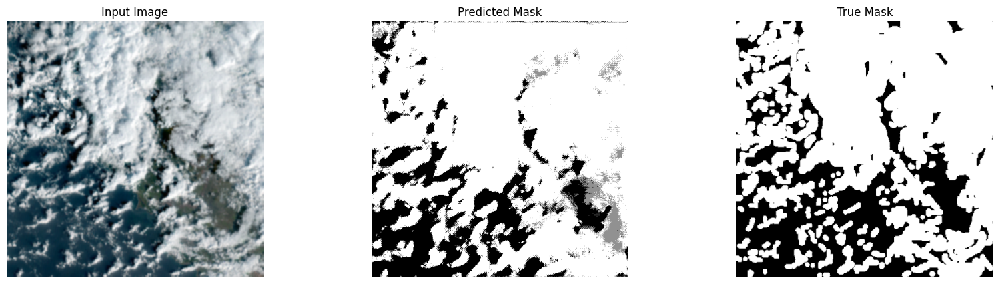

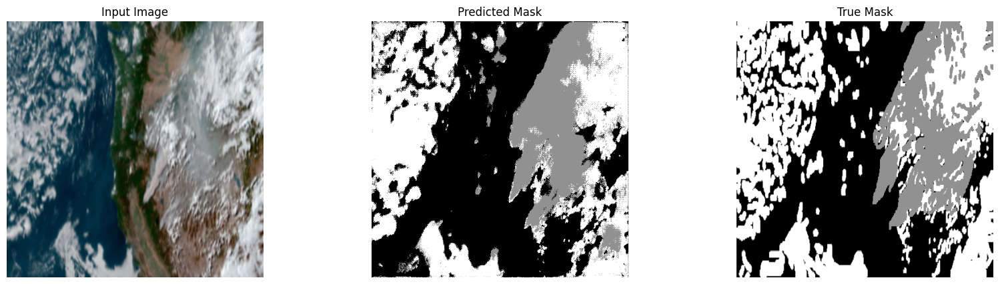

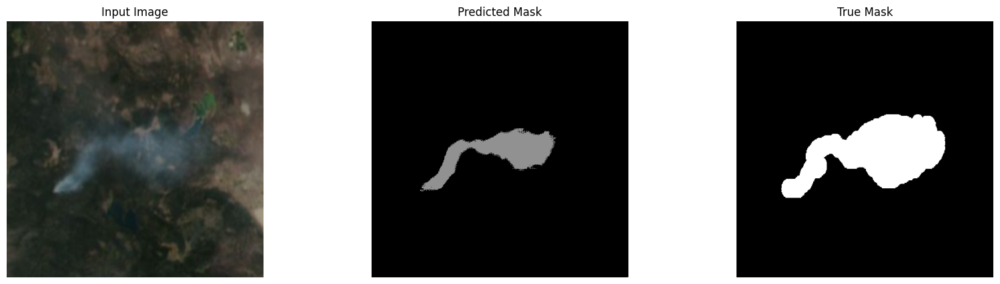

...

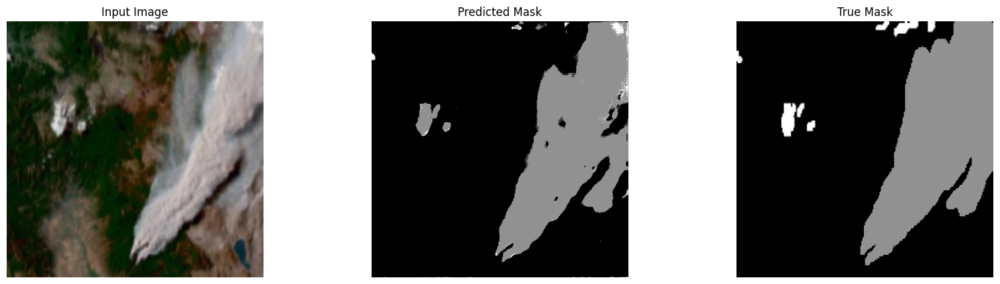

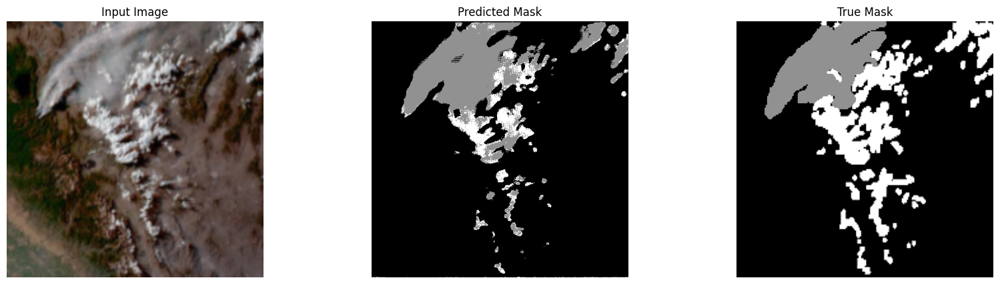

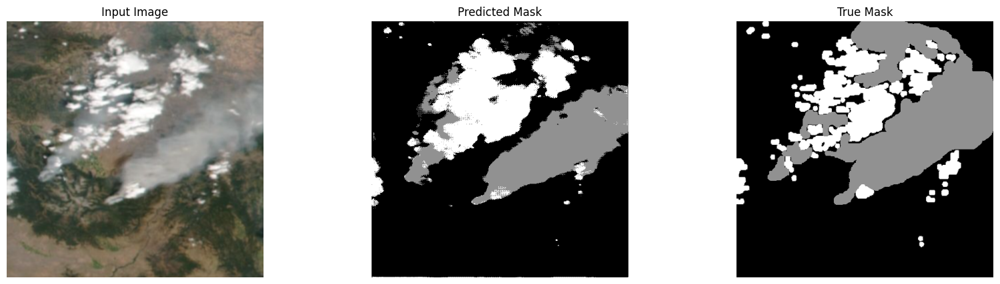

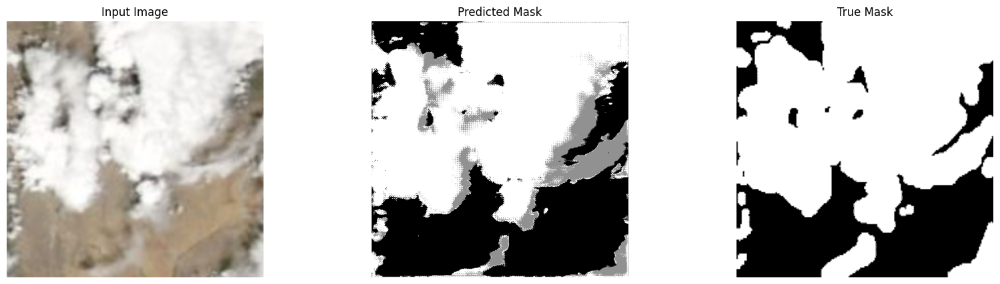

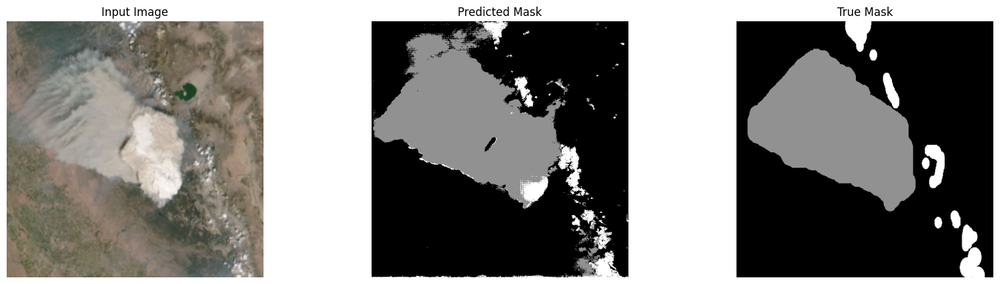

In [44]:

plot_validation_masks(images, preds, labels)

In [45]:
unet_512.save("models/smoke_segmentation_final_512.h5")

In [46]:
mdl = keras.models.load_model("models/smoke_segmentation_final_512.h5")

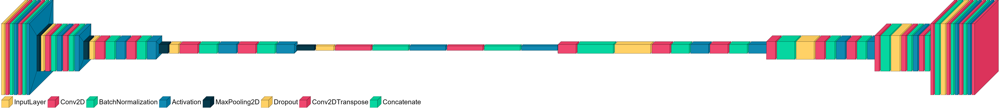

In [47]:
color_map = defaultdict(dict)
color_map[keras.layers.InputLayer]["fill"] = "yellow"
color_map[keras.layers.Conv2D]['fill'] = 'red'
color_map[keras.layers.BatchNormalization]['fill'] = 'green'
color_map[keras.layers.Dropout]['fill'] = 'blue'
color_map[keras.layers.MaxPooling2D]['fill'] = 'teal'
color_map[keras.layers.Conv2DTranspose]['fill'] = "red"
color_map[keras.layers.Concatenate]['fill'] = "grey"
font = ImageFont.truetype("arial.ttf", 48)
visualkeras.layered_view(mdl, legend=True, scale_xy=1, scale_z=1, max_z=1000,font=font,to_file='figures/512_mdl.png', type_ignore=["Activation"])

# (1024, 1024)

In [22]:
input_size = (1024, 1024)

In [23]:
input = tf.keras.layers.Input(shape=(input_size[0], input_size[1], 3))
unet_1024 = Unet(input, dropout= 0.07)

In [24]:
unet_1024.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 1024, 1024,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, 1024, 1024,   448         ['input_1[0][0]']                
                                16)                                                               
                                                                                                  
 batch_normalization (BatchNorm  (None, 1024, 1024,   64         ['conv2d[0][0]']                 
 alization)                     16)                                                           

In [1]:
#tf.keras.utils.plot_model(unet_1024, to_file="figures/1024_keras_mdl.png", show_shapes=True, rankdir="TD")

In [26]:
# Callbacks
early_stop_cb = tf.keras.callbacks.EarlyStopping(
    monitor="val_loss",
    min_delta=0,
    patience=10,
    verbose=1,
    mode="auto",
    baseline=None,
    restore_best_weights=True,
)
model_ckpt_cb = tf.keras.callbacks.ModelCheckpoint(
    "models/smoke_segmentation_1024.h5",
    monitor="val_loss",
    verbose=0,
    save_best_only=True,
    save_weights_only=False,
    mode="auto",
    save_freq="epoch",
)
reduce_lr_cb = tf.keras.callbacks.ReduceLROnPlateau(
    monitor="val_loss",
    factor=0.1,
    patience=5,
    verbose=1,
    mode="auto",
    min_delta=0.0001,
    cooldown=0,
    min_lr=10e-8,
)


In [27]:
# training parameters
batch_size = 4
val_batch_size = 2
epochs = 500
lr = 0.00001

In [28]:
unet_1024.compile(
    loss="sparse_categorical_crossentropy", 
    optimizer=tf.keras.optimizers.Adam(learning_rate=lr), 
    metrics=["accuracy", 
             tf.keras.metrics.MeanIoU(num_classes=3, sparse_y_true=True, sparse_y_pred=False)]
            )

In [29]:
test_dataset = DataLoader(masked_images, originals, target_shape=input_size)
inputs, targets = test_dataset.data_generator(130)

In [30]:
val_input = [inputs[ind] for ind in inds]
val_target = [targets[ind] for ind in inds]
val = tf.data.Dataset.from_tensor_slices((val_input, val_target))

In [31]:
inputs = [inputs[ind] for ind in range(130) if ind not in inds]
targets = [targets[ind] for ind in range(130) if ind not in inds]
train = tf.data.Dataset.from_tensor_slices((inputs, targets))

In [32]:
train_batches = train.batch(batch_size)
val_batches = val.batch(val_batch_size)

In [33]:
history_1024 = unet_1024.fit(
    train_batches,
    validation_data=val_batches,
    batch_size=batch_size,
    epochs=epochs, 
    callbacks=[
        early_stop_cb, 
        model_ckpt_cb, 
        reduce_lr_cb
    ])

Epoch 1/500
27/27 [==============================] - 385s 14s/step - loss: 1.1519 - accuracy: 0.3369 - mean_io_u: 0.1915 - val_loss: 2.9084 - val_accuracy: 0.2453 - val_mean_io_u: 0.1070 - lr: 1.0000e-05
Epoch 2/500
27/27 [==============================] - 374s 14s/step - loss: 1.1151 - accuracy: 0.3583 - mean_io_u: 0.2044 - val_loss: 1.7450 - val_accuracy: 0.3061 - val_mean_io_u: 0.1599 - lr: 1.0000e-05
Epoch 3/500
27/27 [==============================] - 365s 14s/step - loss: 1.0812 - accuracy: 0.3834 - mean_io_u: 0.2196 - val_loss: 1.3184 - val_accuracy: 0.3537 - val_mean_io_u: 0.2091 - lr: 1.0000e-05
Epoch 4/500
27/27 [==============================] - 371s 14s/step - loss: 1.0502 - accuracy: 0.4118 - mean_io_u: 0.2373 - val_loss: 1.1168 - val_accuracy: 0.4186 - val_mean_io_u: 0.2613 - lr: 1.0000e-05
Epoch 5/500
27/27 [==============================] - 366s 14s/step - loss: 1.0220 - accuracy: 0.4434 - mean_io_u: 0.2576 - val_loss: 1.0057 - val_accuracy: 0.4833 - val_mean_io_u: 0.30

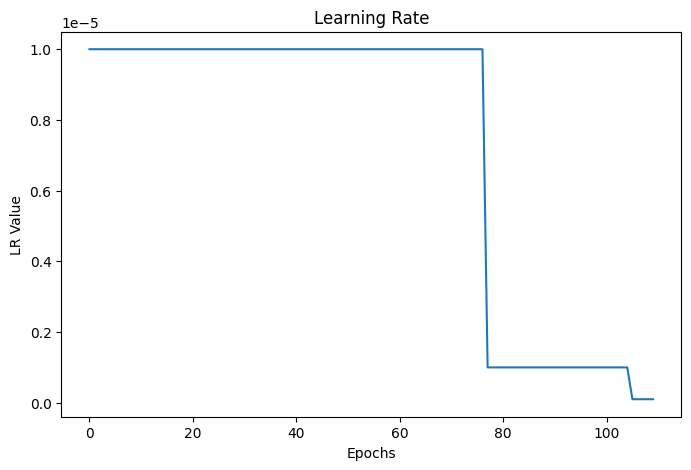

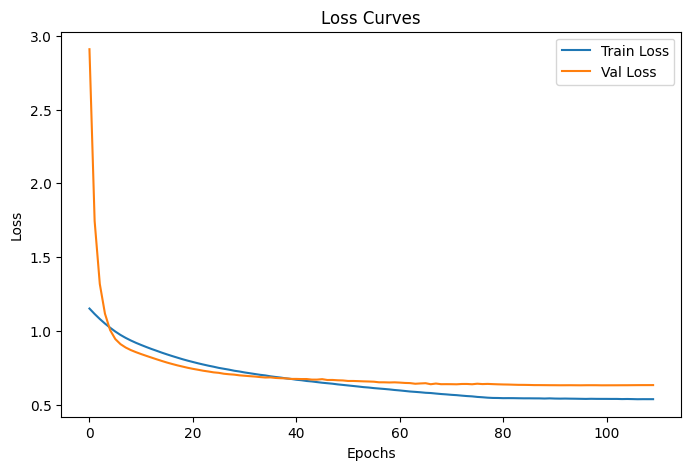

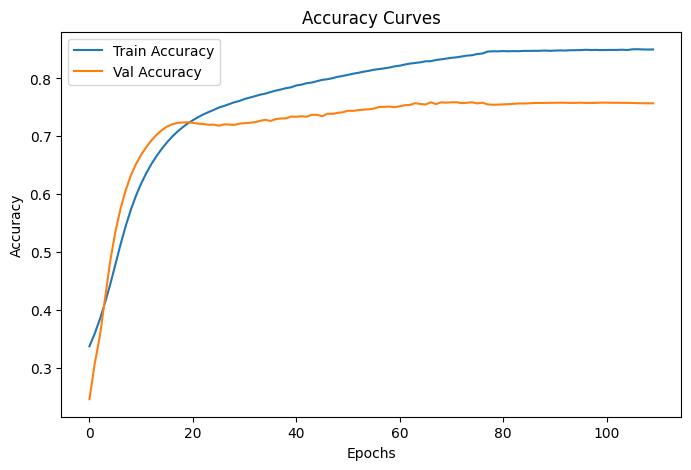

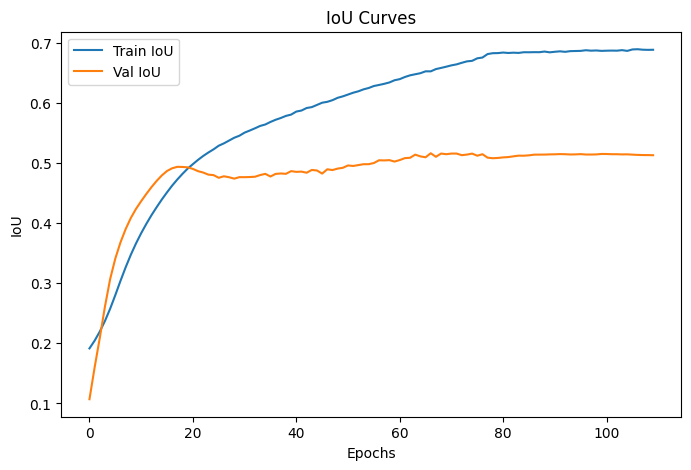

In [34]:
training_plots(history_1024)

In [35]:
from tensorflow.python.ops.numpy_ops import np_config
np_config.enable_numpy_behavior()

In [36]:
train_images, train_labels = tuple(zip(*train))
preds = unet_1024.predict(train_batches)

27/27 [==============================] - 77s 3s/step


In [37]:
print(classification_report(np.array(train_labels).flatten(), np.array(tf.argmax(preds, axis=-1)).flatten()))

              precision    recall  f1-score   support

           0       0.90      0.94      0.92  67733851
           1       0.48      0.76      0.59  20638890
           2       0.88      0.28      0.43  21727739

    accuracy                           0.77 110100480
   macro avg       0.75      0.66      0.64 110100480
weighted avg       0.82      0.77      0.76 110100480



In [38]:
m = tf.keras.metrics.MeanIoU(num_classes=3)
m.update_state(train_labels, tf.argmax(preds, axis=-1))
m.result().numpy()

0.4261942

In [39]:
images, labels = tuple(zip(*val))
preds = unet_1024.predict(val_batches)

13/13 [==============================] - 17s 1s/step


In [40]:
pred_mask = tf.argmax(preds, axis=-1) 

In [41]:
m.reset_state()
m.update_state(labels, pred_mask)
m.result().numpy()

0.5149162

In [42]:
print(classification_report(np.array(labels).flatten(), np.array(pred_mask).flatten()))

              precision    recall  f1-score   support

           0       0.85      0.97      0.91  14571591
           1       0.51      0.67      0.58   5617316
           2       0.88      0.31      0.46   6025493

    accuracy                           0.76  26214400
   macro avg       0.75      0.65      0.65  26214400
weighted avg       0.79      0.76      0.74  26214400



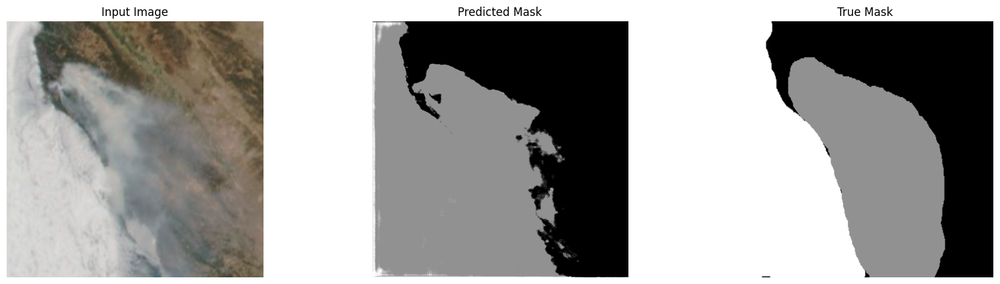

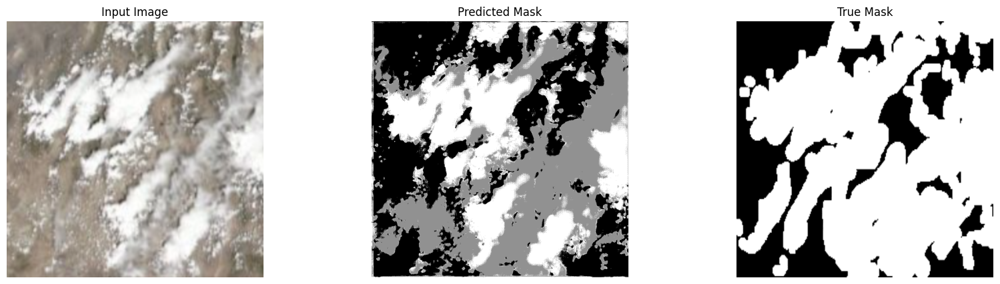

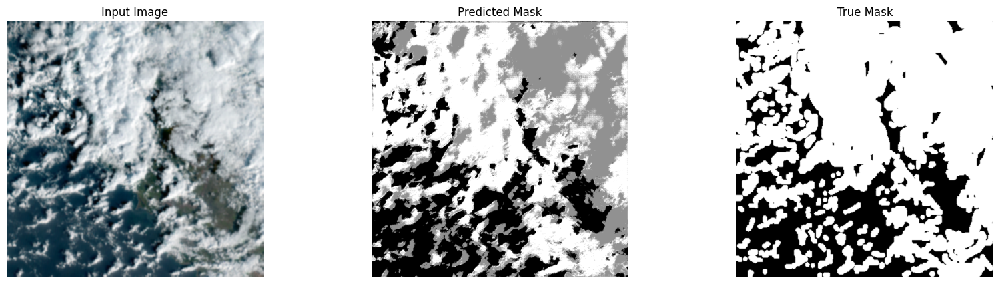

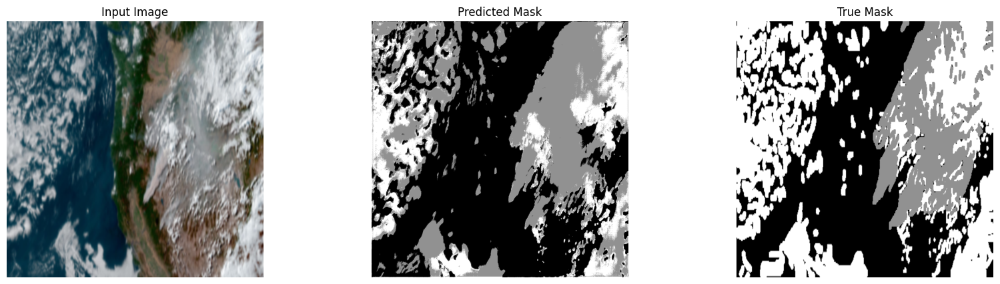

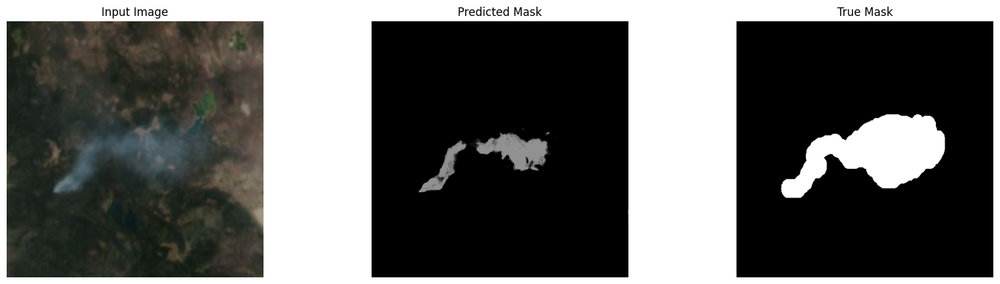

...

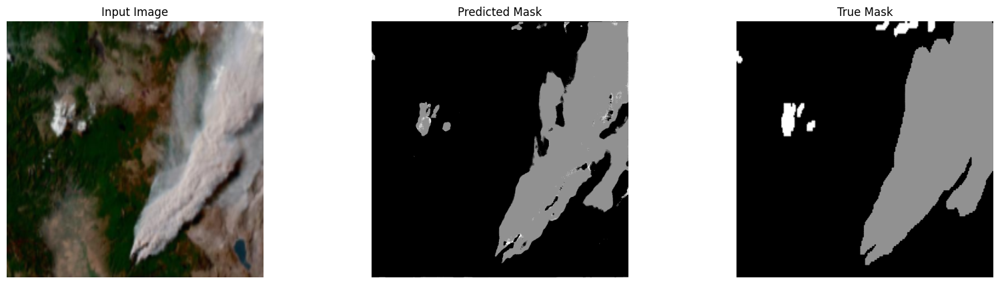

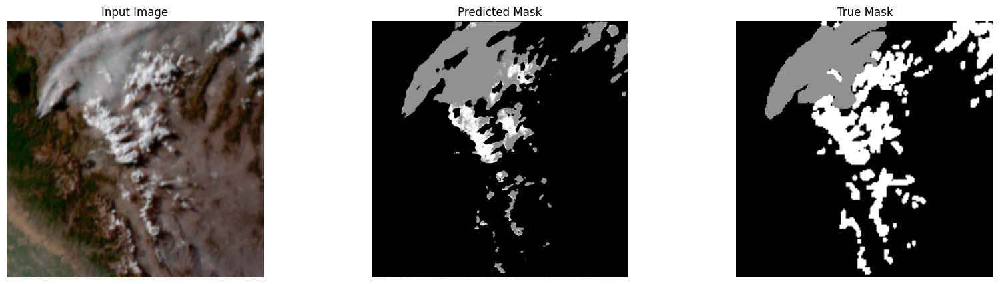

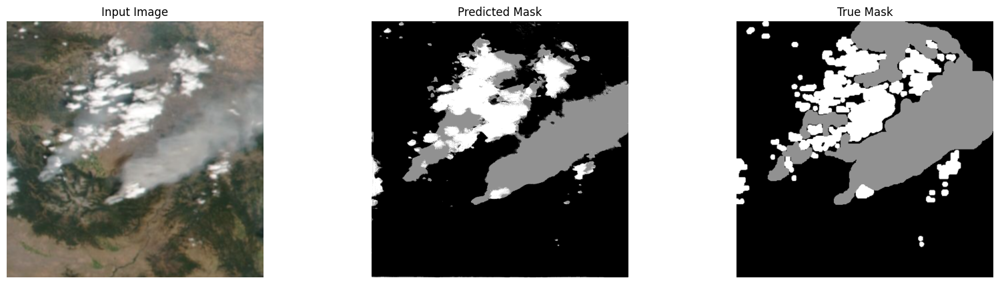

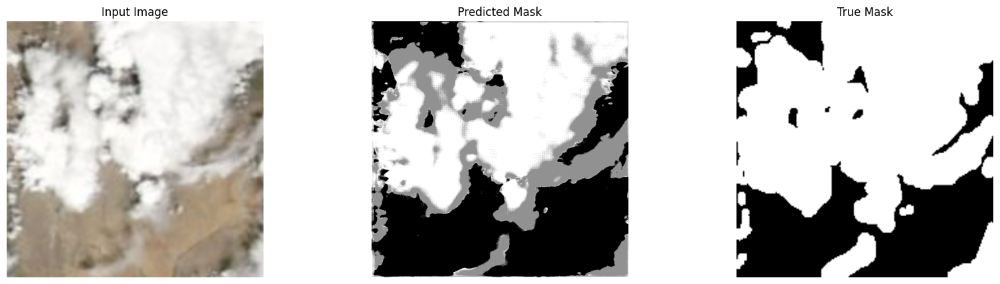

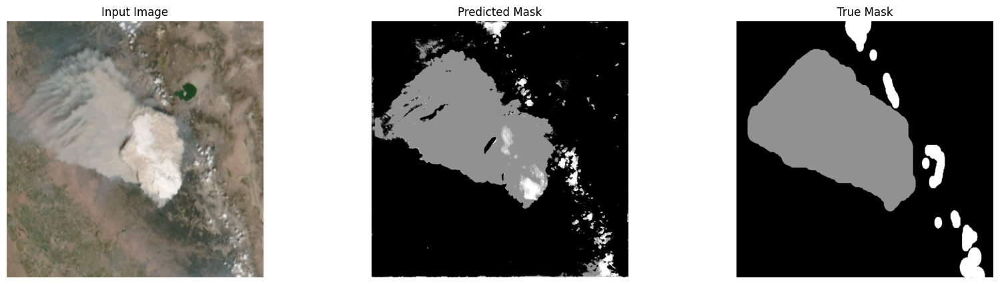

In [43]:

plot_validation_masks(images, preds, labels)

In [44]:
unet_1024.save("models/smoke_segmentation_final_1024.h5")

In [45]:
mdl = keras.models.load_model("models/smoke_segmentation_final_1024.h5")

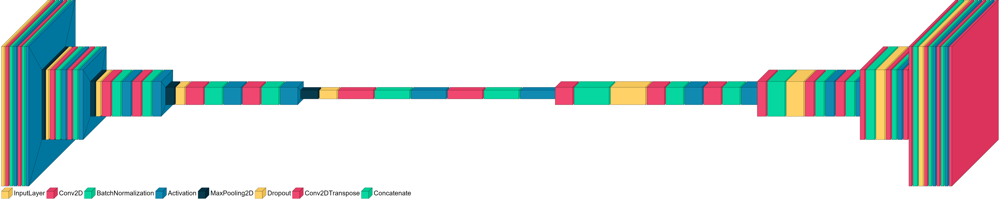

In [46]:
color_map = defaultdict(dict)
color_map[keras.layers.InputLayer]["fill"] = "yellow"
color_map[keras.layers.Conv2D]['fill'] = 'red'
color_map[keras.layers.BatchNormalization]['fill'] = 'green'
color_map[keras.layers.Dropout]['fill'] = 'blue'
color_map[keras.layers.MaxPooling2D]['fill'] = 'teal'
color_map[keras.layers.Conv2DTranspose]['fill'] = "red"
color_map[keras.layers.Concatenate]['fill'] = "grey"
font = ImageFont.truetype("arial.ttf", 48)
visualkeras.layered_view(mdl, legend=True, scale_xy=1, scale_z=1, max_z=1000,font=font,to_file='figures/1024_mdl.png', type_ignore=["Activation"])

# Comparison

In [73]:
random.seed(3)
sample_ind = random.sample(inds, 3)

In [74]:
mdl_256 = keras.models.load_model("models/smoke_segmentation_final_256.h5")
mdl_512 = keras.models.load_model("models/smoke_segmentation_final_512.h5")
mdl_1024 = keras.models.load_model("models/smoke_segmentation_final_1024.h5")

In [75]:
test_dataset = DataLoader(masked_images, originals, target_shape=(256, 256))
inputs, targets = test_dataset.data_generator(130)
sample_input = [inputs[ind] for ind in sample_ind]
sample_target = [targets[ind] for ind in sample_ind]
sam = tf.data.Dataset.from_tensor_slices((sample_input, sample_target))
sam_batch = sam.batch(3)
preds = mdl_256.predict(sam_batch)
pred_256 = tf.argmax(preds, axis=-1)

1/1 [==============================] - 1s 583ms/step


In [76]:
test_dataset = DataLoader(masked_images, originals, target_shape=(512, 512))
inputs, targets = test_dataset.data_generator(130)
sample_input = [inputs[ind] for ind in sample_ind]
sample_target = [targets[ind] for ind in sample_ind]
sam = tf.data.Dataset.from_tensor_slices((sample_input, sample_target))
sam_batch = sam.batch(3)
preds = mdl_512.predict(sam_batch)
pred_512 = tf.argmax(preds, axis=-1)

1/1 [==============================] - 1s 910ms/step


In [77]:
test_dataset = DataLoader(masked_images, originals, target_shape=(1024, 1024))
inputs, targets = test_dataset.data_generator(130)
sample_input = [inputs[ind] for ind in sample_ind]
sample_target = [targets[ind] for ind in sample_ind]
sam = tf.data.Dataset.from_tensor_slices((sample_input, sample_target))
sam_batch = sam.batch(3)
preds = mdl_1024.predict(sam_batch)
pred_1024 = tf.argmax(preds, axis=-1)

1/1 [==============================] - 3s 3s/step


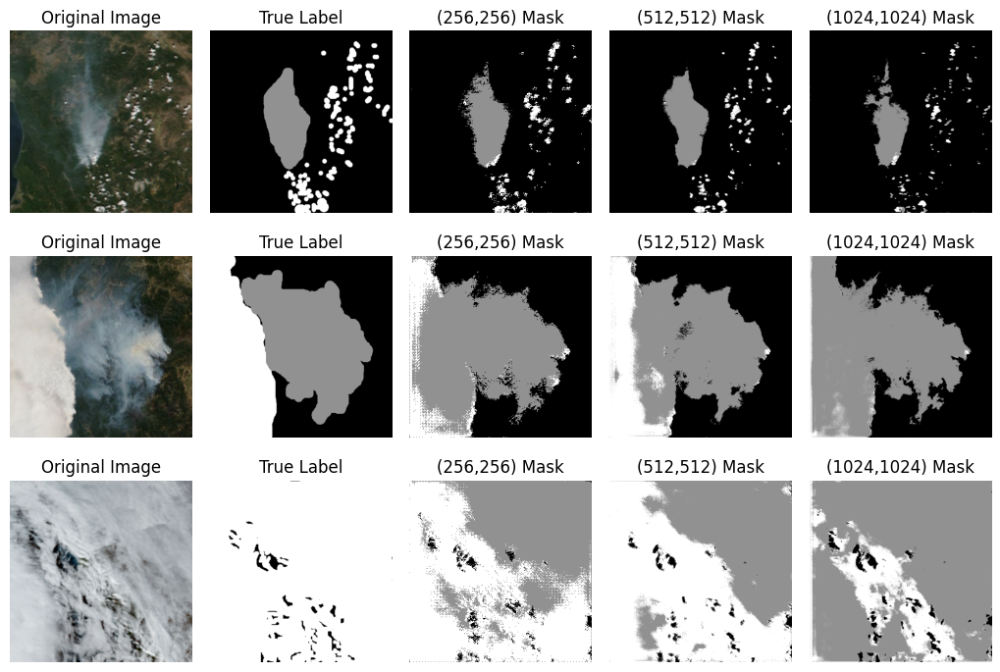

In [84]:
plt.rcParams["figure.figsize"] = (10, 7)
i=0
for ind in range(len(sample_ind)):
    plt.subplot(3, 5, 1+(5*i))
    plt.imshow(sample_input[ind])
    plt.title("Original Image")
    plt.axis("off")

    plt.subplot(3, 5, 2+(5*i))
    plt.imshow(convert_mask_to_colors(sample_target[ind]), cmap='gray')
    plt.title("True Label")
    plt.axis("off")

    plt.subplot(3, 5, 3+(5*i))
    plt.imshow(convert_mask_to_colors(pred_256[i]), cmap='gray')
    plt.title("(256,256) Mask")
    plt.axis("off")

    plt.subplot(3, 5, 4+(5*i))
    plt.imshow(convert_mask_to_colors(pred_512[i]), cmap='gray')
    plt.title("(512,512) Mask")
    plt.axis("off")

    plt.subplot(3, 5, 5+(5*i))
    plt.imshow(convert_mask_to_colors(pred_1024[i]), cmap='gray')
    plt.title("(1024,1024) Mask")
    plt.axis("off")

    i+=1
plt.tight_layout(pad=0)
plt.subplots_adjust(wspace=0.1)
plt.savefig("figures/examples.pdf",bbox_inches="tight")

